<a href="https://colab.research.google.com/github/mohdsaadoon/computer-vision/blob/main/OpenCV_Surgery_101.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#OpenCV Surgery 101

This notebook aims to delve into essential techniques of computer vision and image processing. Two images captured by my iPhone around Coogee Beach will be utilized in this notebook, but feel free to use any image of your choice.

In this notebook, we will showcase the effectiveness of OpenCV techniques as follows:
* Loading Image 
* Resizing & Interpolation
* Translation
* Rotation
* Flipping
* Cropping
* Image Arithmetic
* Splitting & Merging Channels


Each of these techniques will be thoroughly covered. So let's get started and commence our exploration.


##Python getting started

Firstly, to get access to images we need to Mount the Google Drive to Google Colab.


In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In the beginning, I mentioned that the images were captured using an iPhone. These images are in the [HEIC](https://www.adobe.com/au/creativecloud/file-types/image/raster/heic-file.html) format,  which is Apple's standard image format. To work with these images effectively, we will utilize the [pyheif](https://pypi.org/project/pyheif/) library. This library allows us to read the HEIC files and convert them into more widely supported formats like PNG or JPEG. By doing so, we ensure compatibility with different image processing libraries commonly used in computer vision. Additionally, we need to import essential libraries such as OpenCV, Numpy, and a few others for our tasks.



In [2]:
# Importing the necessary Python packages

# We begin by installing the "pyheif" library using the pip package manager. This library enables us to work with HEIC image files.
!pip install pyheif

import pyheif  # Importing the pyheif library to handle HEIC files and convert them to more widely supported formats
import numpy as np  # Importing numpy for efficient numerical operations and array manipulation
from google.colab.patches import cv2_imshow  # Importing cv2_imshow from google.colab.patches to display images in Google Colab
from PIL import Image  # Importing PIL.Image for image processing capabilities
import cv2  # Importing cv2 from OpenCV for computer vision tasks
import matplotlib.pyplot as plt  # Importing matplotlib.pyplot for creating visualizations
import imutils  # Importing imutils for image resizing, rotating, and cropping
import os  # Importing os for interacting with the operating system, such as file handling and directory manipulation

# These imported packages will be essential for our image processing and computer vision tasks.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.8/9.8 MB 56.0 MB/s eta 0:00:00





The function bellow will convert a HEIC image into PNG format. This function takes two arguments the **heic_path**, which is the path to the input HEIC image, and the **png_path**, the path where the output will be saved as a PNG image.



In [3]:
def convert_heic_to_png(heic_path, png_path):
    """
    Converts a HEIC image to PNG format and saves the output to a specified path.

    Args:
        heic_path (str): Path to the input HEIC image.
        png_path (str): Path to save the output PNG image.

    Returns:
        None.
    """
    heic_image = pyheif.read(heic_path)  # Read the input HEIC image
    rgb_image = Image.frombytes(  # Convert the HEIC image to RGB format
        heic_image.mode,
        heic_image.size,
        heic_image.data,
        "raw",
        heic_image.mode,
        heic_image.stride,
    )
    rgb_image.save(png_path, "PNG")  # Save the RGB image to PNG format at the specified path


To convert the two images conveniently, the **convert_heic_images** function  designed to convert multiple HEIC photos. The first arguments are **heic_paths**, a list of paths to the input HEIC images, and **output_dir**, the dir where the converted PNG images will be saved.

In [4]:

def convert_heic_images(heic_paths, output_dir):
    # Check if the output directory exists and create it if it doesn't
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    # Iterate over the HEIC image paths and convert each image to PNG format
    for path in heic_paths:
        filename = os.path.basename(path).split(".")[0] + ".png"
        output_path = os.path.join(output_dir, filename)
        convert_heic_to_png(path, output_path)


In [5]:
# Convert the HEIC images to PNG format and save to a new location in the /content directory
heic_paths = ["/content/drive/MyDrive/IMG_1655.HEIC", "/content/drive/MyDrive/IMG_1650.HEIC"]
output_dir = "/content/png_images"
convert_heic_images(heic_paths, output_dir)




##Loading Image with OpenCV



In [6]:
# Load the two converted images
bike = cv2.imread('/content/png_images/IMG_1650.png')
coogee_beach = cv2.imread('/content/png_images/IMG_1655.png')

####In this section we'll see how to plot the bike image in different ways:


*   The **cv2_imshow()** funcation provided by Google Colab that allows us to disply images directly within the Colab notebook enviroment.Specifically designed to work with images in the BGR (Blue-Green-Red) format used by OpenCV.



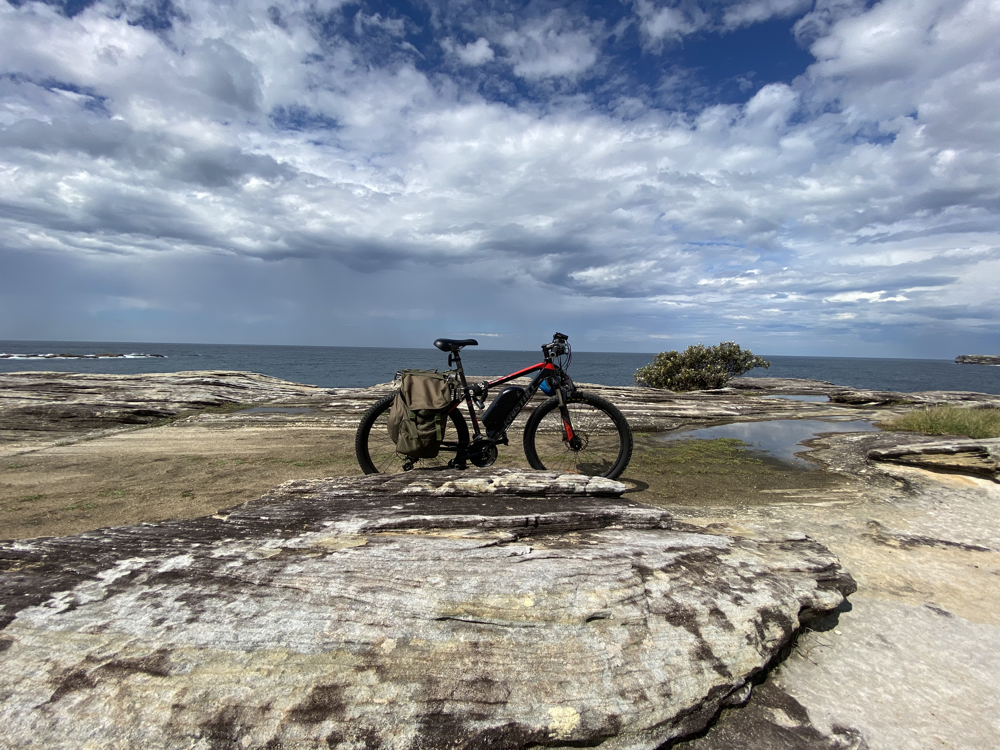

In [7]:
cv2_imshow(bike)

------

*   The **plt.imshow()** is a powerful function for visualizing images in Python using the **matplotlib** library. To display the image, we need to ensure that the image is in the appropriate format. As we can see here, the *plt.imshow* will plot the image in the BGR (Blue-Green-Red) format.








(-0.5, 4031.5, 3023.5, -0.5)

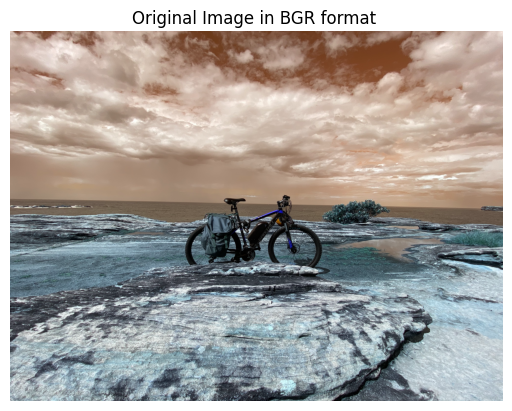

In [8]:
plt.imshow(bike)
plt.title("Original Image in BGR format ")
plt.axis('off')

-----

*   To visualize the image using *plt.imshow* in RGB (Red, Green, Blue) instead of BGR(Blue, Green, Red) format, we have to call **cv2.cvtColor** function used for colour space conversion. It allows to convert images from one colour space to another.


(-0.5, 4031.5, 3023.5, -0.5)

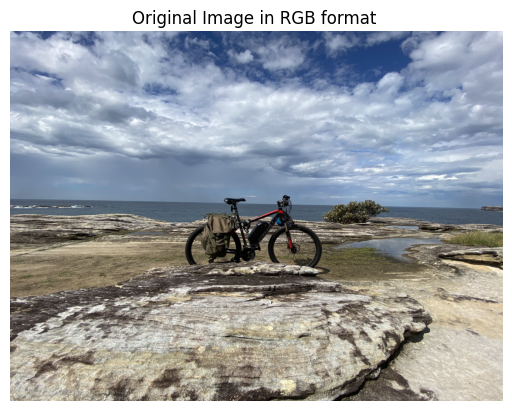

In [9]:
plt.imshow(cv2.cvtColor(bike,cv2.COLOR_BGR2RGB))
plt.title("Original Image in RGB format ")
plt.axis('off')

------
* The **imutils.opencv2matplotlib** function is convenient as it allows us to directly plot images in their original BGR (Blue, Green, Red) format without the need to convert them. This saves us from the extra step of using cv2.cvtColor to convert the image format from RGB (Red, Green, Blue) to BGR (Blue, Green, Red) when using plt.imshow.


(-0.5, 4031.5, 3023.5, -0.5)

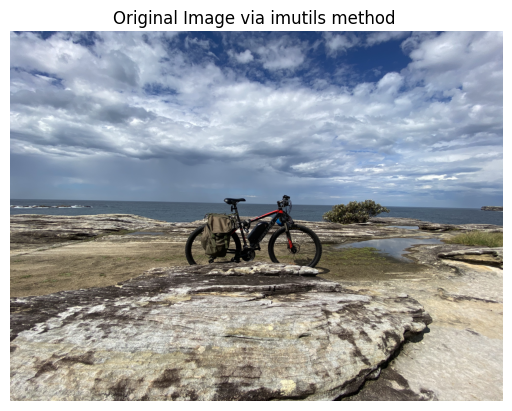

In [10]:
plt.imshow(imutils.opencv2matplotlib(bike))
plt.title("Original Image via imutils method ")
plt.axis('off')

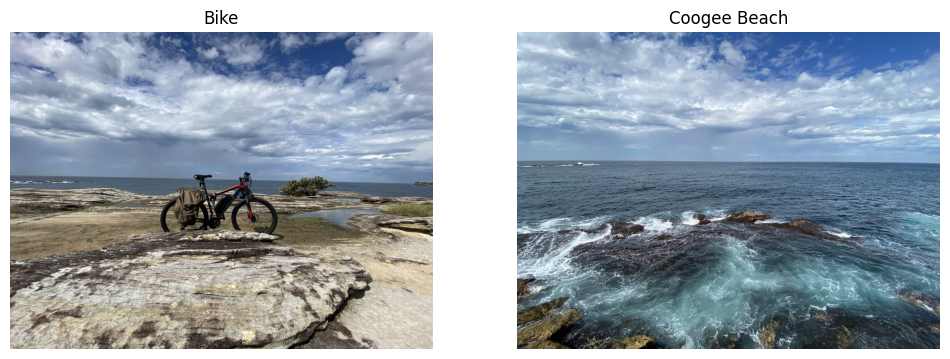

In [11]:
# Plotting the two converted images

# Create a subplot with two columns for displaying the images side by side
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# Display the first image
#ax[0].imshow(cv2.cvtColor(bike,cv2.COLOR_BGR2RGB)) #Uncomment this line and check it will be the same output
ax[0].imshow(imutils.opencv2matplotlib(bike))  # Convert the image to RGB format for display
ax[0].set_title("Bike")  # Set the title for the first image
ax[0].axis("off")  # Turn off the axes for the first image

# Display the second image
#ax[1].imshow(cv2.cvtColor(coogee_beach,cv2.COLOR_BGR2RGB)) #Uncomment this line and check it will be the same output
ax[1].imshow(imutils.opencv2matplotlib(coogee_beach))  # Convert the image to RGB format for display
ax[1].set_title("Coogee Beach")  # Set the title for the second image
ax[1].axis("off")  # Turn off the axes for the second image


plt.show()  # Display the plot

-----------------------

In the provided code, two print statements examine the dimensions of two images: "bike" and "coogee_beach". The dimensions include the width, height, and number of channels.



*   **Pixels**: A pixel is the smallest unit of an image. It represents a single 
point and holds information about its colour and intensity. In the context of digital images, pixels are arranged in a grid-like structure, forming the image. Each pixel can be considered a tiny square containing a specific colour value.

* **Channels**: In digital images, channels represent the colour components of each pixel. Colour images comprise three primary colour channels: red, green, and blue (RGB). Each channel contains intensity values that determine the contribution of that colour to the overall pixel colour.



1. For the "bike" image:
* Width: bike.shape[1] pixels
* Height: bike.shape[0] pixels
* Channels: bike.shape[2]

2. For the "coogee_beach" image:
* Width: coogee_beach.shape[1] pixels
* Height: coogee_beach.shape[0] pixels
* Channels: coogee_beach.shape[2]

By examining the dimensions of the images, you can understand the image's resolution (width and height) and the number of colour channels present. This information is essential for image processing tasks, allowing you to effectively manipulate and analyze the images.

In [12]:
# print the bike format
print(f"Examine the dimensions of the bike\nwidth: {bike.shape[1]} pixels\nheight: {bike.shape[0]} pixels\nchannels: {bike.shape[2]}")

# print the beach format
print(f"Examine the dimensions of the beach\nwidth: {coogee_beach.shape[1]} pixels\nheight: {coogee_beach.shape[0]} pixels\nchannels: {coogee_beach.shape[2]}")


Examine the dimensions of the bike
width: 4032 pixels
height: 3024 pixels
channels: 3
Examine the dimensions of the beach
width: 4032 pixels
height: 3024 pixels
channels: 3


###Resizing with OpenCV


Resizing images is a crucial technique in computer vision for adjusting their dimensions. OpenCV provides the **cv2.resize()** function specifically designed for this purpose. Preserving the aspect ratio while resizing is essential to avoid distortions and maintain the visual integrity of the image.

To illustrate the power of **cv2.resize()**, let's explore two examples. In the first example, we resize an original image of a bike to a fixed size of 300x300 pixels. Although this transformation slightly compresses the aspect ratio and results in some loss of details, it demonstrates the simplicity of fixed-size resizing.



(-0.5, 299.5, 299.5, -0.5)

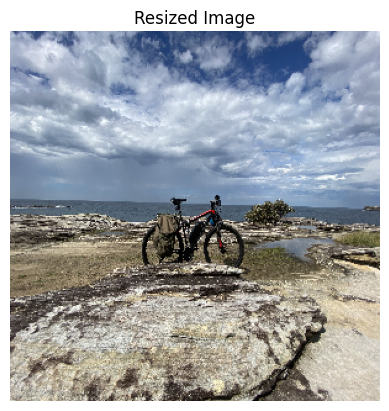

In [13]:
# Resizig the bike image 
resized_bike = cv2.resize(bike, (300, 300))

# Plot the resized image
plt.imshow(cv2.cvtColor(resized_bike,cv2.COLOR_BGR2RGB))
plt.title("Resized Image")
plt.axis('off')

------

In the second example, we took a different approach by resizing the image while preserving its aspect ratio. We achieved a visually pleasing output that retains most of the original details and proportions by calculating the new dimensions based on the original aspect ratio and a target size of 300x300 pixels. This adaptive resizing technique showcases the artistry behind preserving the essence of an image during transformation.



(-0.5, 299.5, 224.5, -0.5)

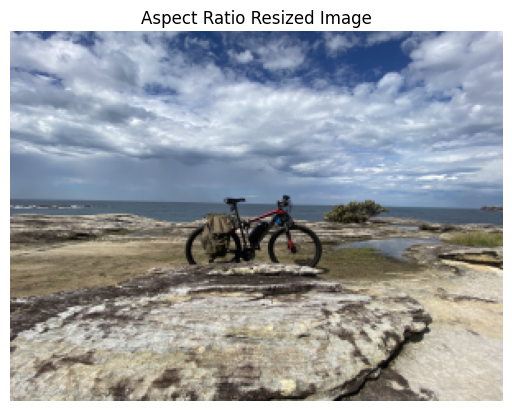

In [14]:
# Resizig the bike image ASPECT RATIO:
r = 300.0 / bike.shape[1]                                   # Initializing AR. 
dim = (300, int(bike.shape[0] * r))                         # Initialization. 
ratio_resized_bike = cv2.resize(bike, dim,interpolation=cv2.INTER_AREA)                # Resizing Image. 
plt.imshow(cv2.cvtColor(ratio_resized_bike,cv2.COLOR_BGR2RGB))# plot Image. 
plt.title("Aspect Ratio Resized Image") 
plt.axis('off')   

--------
By comparing the two images, we visually explore the impact of different resizing techniques on the final appearance and composition. As aspiring computer vision enthusiasts, selecting the appropriate resizing method and parameters is crucial to achieving the desired visual outcome.

The code below will appropriately plot the two resized images to see the difference between the two resizing techniques in  OpenCV.


In [15]:
''''
# Set the desired width and height for resizing
target_width = 300
target_height = 300

# Resize the first image
resized_bike = cv2.resize(bike, (target_width, target_height))

# Calculate the aspect ratio of the original image
aspect_ratio = bike.shape[1] / bike.shape[0]

# Calculate the new width and height based on the aspect ratio and target size
if aspect_ratio > 1:
    new_width = target_width
    new_height = int(new_width / aspect_ratio)
else:
    new_height = target_height
    new_width = int(new_height * aspect_ratio)

# Resize the second image using the calculated width and height
ratio_resized_bike = cv2.resize(bike, (new_width, new_height), interpolation=cv2.INTER_AREA)

# Create a figure with subplots
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Plot the resized image
axs[0].imshow(cv2.cvtColor(resized_bike, cv2.COLOR_BGR2RGB))
#axs[0].imshow(imutils.opencv2matplotlib(resized_bike))
axs[0].set_title("Resized Image")
axs[0].axis("off")

# Plot the aspect ratio resized image
axs[1].imshow(cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB))
#axs[1].imshow(imutils.opencv2matplotlib(ratio_resized_bike))
axs[1].set_title("Aspect Ratio Resized Image")
axs[1].axis("off")

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()
''''

SyntaxError: ignored

###Interpolation with OpenCV

Interpolation is a fascinating technique that enables us to analyze pixel neighbourhoods and utilize them to effectively scale up or down the size of an image without introducing significant distortions. This method is crucial in various image processing operations, such as resizing, rotating, and transforming images. OpenCV offers diverse interpolation methods, each with strengths and weaknesses. Let's delve deeper into these methods by exploring the following code snippet.

--------


* **cv2.INTER_NEAREST:** Is a straightforward interpolation method that determines the intensity value of a new pixel by selecting the nearest neighbouring pixel from the original image. Instead of using complex calculations or weighted averages, this method assigns the same pixel value to the new location. While the nearest-neighbour interpolation is fast and efficient, it comes with a trade-off in image quality. Resized images using this method often exhibit lower quality and may display noticeable "blocky" artifacts. Nonetheless, it is a quick and convenient option for scenarios where speed is prioritized over precise image rendering.


(-0.5, 299.5, 224.5, -0.5)

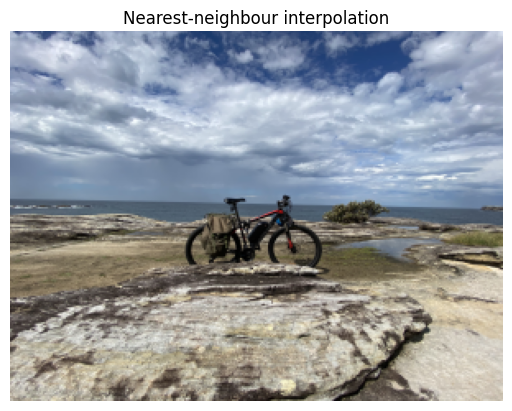

In [16]:
plt.imshow(cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB,cv2.INTER_NEAREST))
plt.title("Nearest-neighbour interpolation") 
plt.axis('off') 


------------

* **cv2.INTER_LINEAR:** The bilinear interpolation is the default method employed by OpenCV for resizing images. This method work by considering neighbouring pixels and calculating a weighted average that produces interpolated values that enhance the overall quality of the resized image. This method balances computational speed and image fidelity, making it suitable for many image-processing tasks.






(-0.5, 299.5, 224.5, -0.5)

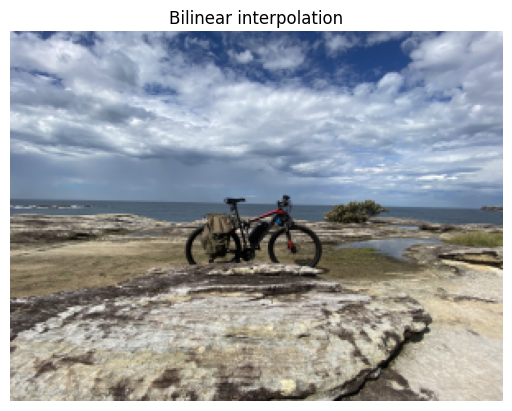

In [17]:
plt.imshow(cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB,cv2.INTER_LINEAR))
plt.title("Bilinear interpolation") 
plt.axis('off') 

---------------

* **cv2.INTER_CUBIC:** The bicubic interpolation method takes the weighted average of a 4x4 neighbourhood of pixels surrounding the new pixel location, adding a touch of smoothness and finesse to the resizing process. cv2.INTER_LANCZOS4: The mystical Lanczos interpolation method employs a windowed sinc function to weave its spell, interpolating pixel values over an 8x8 pixel region. However, due to its computational complexity, it is rarely summoned in practice.

(-0.5, 299.5, 224.5, -0.5)

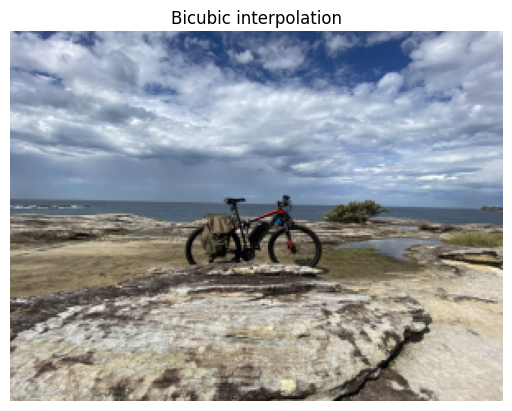

In [18]:
plt.imshow(cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB,cv2.INTER_CUBIC))
plt.title("Bicubic interpolation") 
plt.axis('off') 

(-0.5, 299.5, 224.5, -0.5)

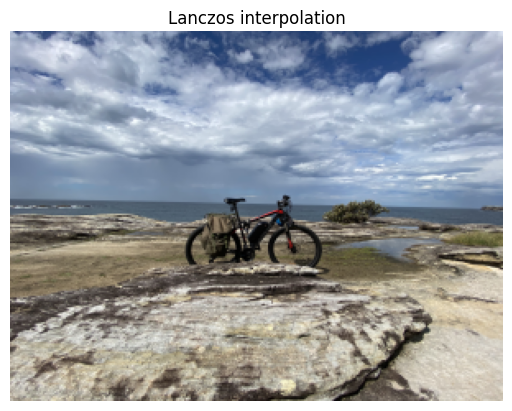

In [19]:

plt.imshow(cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB,cv2.INTER_LANCZOS4))
plt.title("Lanczos interpolation") 
plt.axis('off') 

-------------

* **cv2.INTER_AREA:** method gracefully performs area-based interpolation by determining pixel values based on the pixel area relation. It calculates each pixel's value in the output image as the average of the corresponding region in the input image. The choice of interpolation method depends on specific requirements for your computer vision task, taking into consideration factors such as desired quality and processing speed. In general, bilinear interpolation (cv2.INTER_LINEAR) provides a balance between speed and quality

(-0.5, 299.5, 224.5, -0.5)

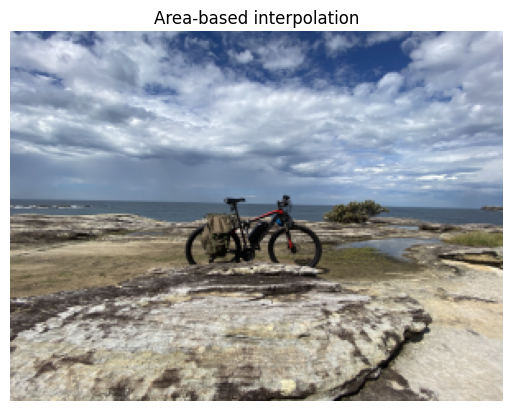

In [19]:
plt.imshow(cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB,cv2.INTER_AREA))
plt.title("Area-based interpolation") 
plt.axis('off') 

In [ ]:
'''
interpolation_methods = [
    ("cv2.INTER_NEAREST", cv2.INTER_NEAREST),
    ("cv2.INTER_LINEAR", cv2.INTER_LINEAR),
    ("cv2.INTER_CUBIC", cv2.INTER_CUBIC),
    ("cv2.INTER_LANCZOS4", cv2.INTER_LANCZOS4),
    ("cv2.INTER_AREA", cv2.INTER_AREA)
]

# Create a figure and axes for the subplots
fig, axs = plt.subplots(len(interpolation_methods), 1, figsize=(5, 25))

# Iterate over the interpolation methods and plot the resized images
for i, (name, method) in enumerate(interpolation_methods):
    resized = cv2.resize(bike, None, fx=2, fy=2, interpolation=method)
    axs[i].imshow(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
    axs[i].set_title(name)
    axs[i].axis("off")

# Adjust spacing between subplots
plt.tight_layout()
# Show the plot
plt.show()
'''

(-0.5, 299.5, 224.5, -0.5)

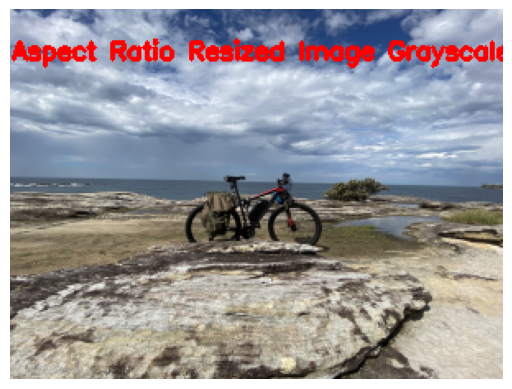

In [20]:
# Convert the resized image to grayscale
#gray_img = cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2GRAY)

# Convert the grayscale image back to color
color_img = cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB)
#gray_img  = imutils.opencv2matplotlib(ratio_resized_bike)
# draw text on image
cv2.putText(color_img, "Aspect Ratio Resized Image Grayscale", (1, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

# Display the image
plt.imshow(color_img) 
plt.axis('off') 




###Translation with OpenCV

Image translation is a  fundamental technique in computer vision that allows for precise shifts of images in any direction by a specified number of pixels. It has wide-ranging applications, including camera motion correction, image composition adjustment, and preprocessing for advanced analysis. OpenCV provides robust tools for image translation, notably the renowned cv2.warpAffine function.Additionally, the imutils package offers a range of convenience functions for basic image processing operations like translation.

Let's delve into the cv2.warpAffine function, a powerful tool in OpenCV. It operates by utilizing a 2x3 affine transformation matrix that grants us control over each pixel's destiny. Within this matrix, the translation amounts t_{x} and t_{y} hold the key to shifting the image along the x and y directions, respectively. Mastering their interplay allows us to achieve the desired effects with finesse.

1.    Negative values of t_{x} shift the image to the left
2.    Positive values of t_{x} shift it to the right
3.    Negative values of t_{y} shift the image up
4.    Positive values of t_{y} shift it down.
   

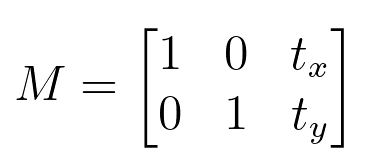


On the other hand, imutils.translate attracts us with its simplicity and ease. By declaring the shift amounts, this tool constructs the translation matrix internally, making translation operations straightforward and effortless. It prioritizes convenience. However, if we require more complex transformations like rotation or scaling, cv2.warpAffine becomes the preferred choice. It offers a versatile canvas for creating intricate designs.

The following code is a guiding light, leading us to master image translation. Explore the provided practical examples and witness the wonders of cv2.warpAffine and imutils.translate in action.

*Hint: When working with image translation, remember to convert the image to the RGB format after applying shifts, as demonstrated in the code examples. This step guarantees that plt.imshow accurately represents your masterpiece with vivid colours.

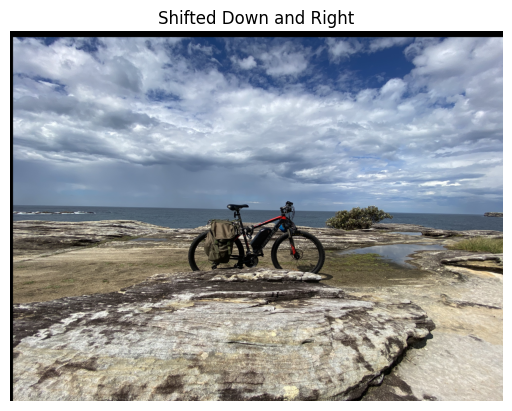

In [21]:
# shift the image 25 pixels to the right and 50 pixels down
M = np.float32([[1, 0, 25], [0, 1, 50]])
shifted = cv2.warpAffine(bike, M, (bike.shape[1], bike.shape[0]))

# convert color space to RGB
shifted = cv2.cvtColor(shifted, cv2.COLOR_BGR2RGB)

# Display the shifted image
plt.imshow(shifted)  # Show the image
plt.title("Shifted Down and Right")  # Set the title of the plot
plt.axis("off")  # Turn off the axis
plt.show()  # Display the plot



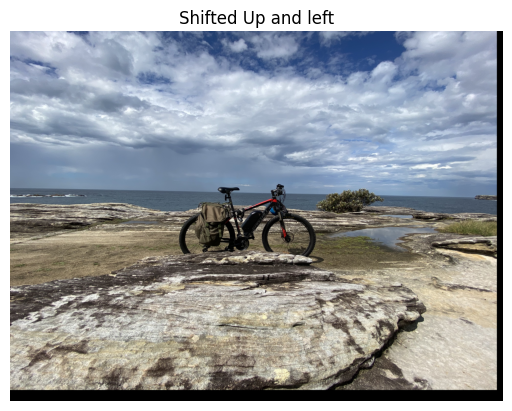

In [22]:
# shift the image 50 pixels to the left and 90 pixels up
M = np.float32([[1, 0, -50], [0, 1, -90]])
shifted = cv2.warpAffine(bike, M, (bike.shape[1], bike.shape[0]))

# convert color space to RGB
shifted = cv2.cvtColor(shifted, cv2.COLOR_BGR2RGB)

# Display the shifted image
plt.imshow(shifted)
plt.title("Shifted Up and left")
plt.axis("off") 
plt.show() 


(-0.5, 4031.5, 3023.5, -0.5)

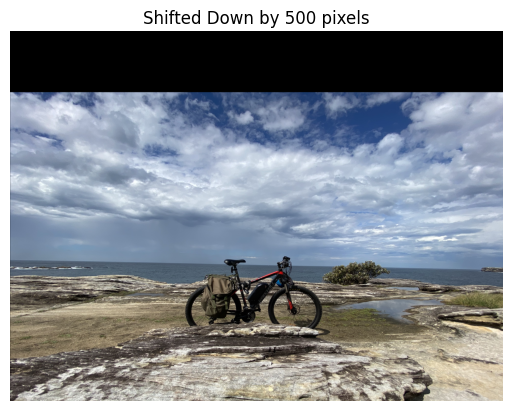

In [23]:
# Shift the image down by 500 pixels
shifted = imutils.translate(bike, 1, 500)
# Convert color space to RGB
shifted = cv2.cvtColor(shifted, cv2.COLOR_BGR2RGB)

# Display the shifted image
plt.imshow(shifted)
plt.title("Shifted Down by 500 pixels")
plt.axis("off")

(-0.5, 4031.5, 3023.5, -0.5)

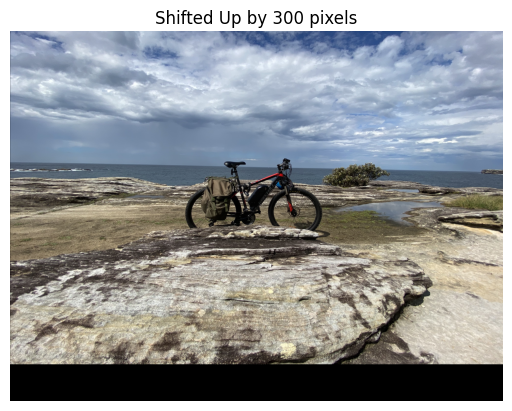

In [24]:
# Shift the image up by 300 pixels
shifted = imutils.translate(bike, 1, -300)
# Convert color space to RGB
shifted = cv2.cvtColor(shifted, cv2.COLOR_BGR2RGB)

# Display the shifted image
plt.imshow(shifted)
plt.title("Shifted Up by 300 pixels")
plt.axis("off")

#Rotation with OpenCV

Image rotation is a powerful technique in computer vision that enables us to rotate an image by a specified angle, allowing for perspective manipulation and exploration of new dimensions. This section will explore OpenCV's image rotation capabilities and uncover the secrets behind this transformative process.

The code snippet below demonstrates the implementation of image rotation using OpenCV. Let's break it down step by step:

1.  First, we define the image's dimensions and calculate the centre coordinates (cX, cY) based on the shape of the bike image.
2.  Next, we specify a list of rotation angles (rotation_angles) that determine the extent and direction of the desired rotations.

Now, let's delve into the code's intriguing aspect. Inside the for loop, you'll notice three distinct methods used to rotate an image:

* imutils.rotate: This function, available in the imutils library, provides a 
convenient way to rotate an image with a single function call.
* imutils.rotate_bound: Also part of the imutils library, this function ensures that no part of the image is cut off during rotation, preserving its boundaries.
* cv2.rotate: This method is built into OpenCV but requires constructing a rotation matrix and explicitly applying an affine warp, resulting in more verbose code.

We gain flexibility and adaptability when performing image rotations by utilising these different techniques. Depending on our specific requirements, we can leverage the simplicity of imutils.rotate, the boundary preservation of imutils.rotate_bound, or the customisation options provided by cv2.rotate.

*Hint: In most cases, the rotation will be around the centre of the image. However, OpenCV allows us to specify an arbitrary point if desired. Positive degrees indicate counterclockwise rotation, while negative degrees indicate clockwise rotation.

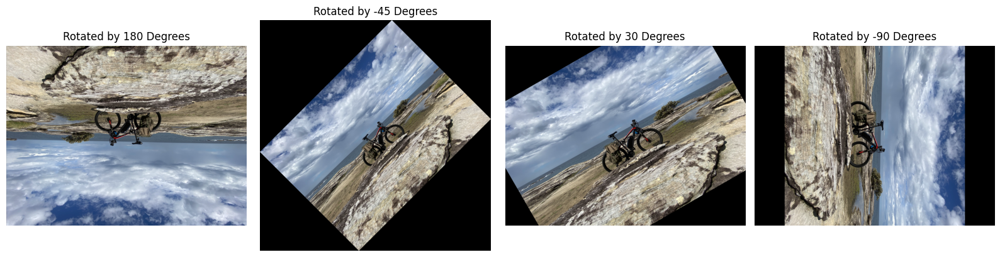

In [25]:
#Define dimensions of the image and calculate the center of the image
(h, w) = bike.shape[:2]
(cX, cY) = (w // 2, h // 2)

# Define the rotation angles
rotation_angles = [180, -45, 30, -90]

# Create a figure with subplots
fig, axs = plt.subplots(1, len(rotation_angles), figsize=(16, 4))

# Iterate over the rotation angles
for i, angle in enumerate(rotation_angles):
    # Rotate the image
    if angle == 180:
        rotated = imutils.rotate(bike, angle)
    elif angle == -45:
        rotated = imutils.rotate_bound(bike, angle)
    else:
        M = cv2.getRotationMatrix2D((cX, cY), angle, 1.0)
        rotated = cv2.warpAffine(bike, M, (w, h))
    
    # Plot the rotated image
    axs[i].imshow(cv2.cvtColor(rotated, cv2.COLOR_BGR2RGB))
    axs[i].set_title(f"Rotated by {angle} Degrees")
    axs[i].axis("off")

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


(-0.5, 4031.5, 3023.5, -0.5)

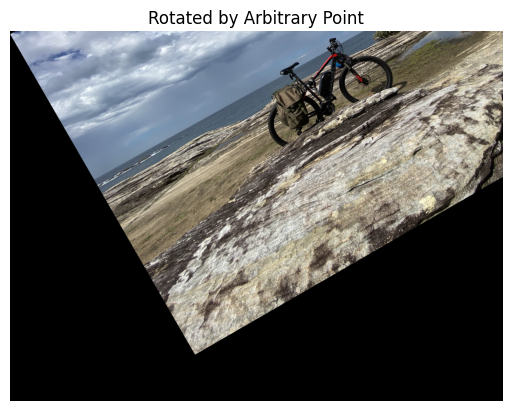

In [26]:
# Define the rotation parameters
# Rotate the image 30 degrees with a scaling factor of 1.0
# The rotation will be around the point (50, 10)
M = cv2.getRotationMatrix2D((50, 10), 30, 1.0)

# Apply the rotation to the image using the warpAffine function
rotated = cv2.warpAffine(bike, M, (w, h))

# Display the rotated image
plt.imshow(cv2.cvtColor(rotated, cv2.COLOR_BGR2RGB))
plt.title("Rotated by Arbitrary Point")
plt.axis('off')


#OpenCV Flip Image 

Image flipping is a typical operation in image processing that reverses an image's spatial orientation along a specific axis. OpenCV provides the **cv2.flip()** function for image flipping, allowing you to create mirror images or change the image's exposure.

To flip an image using **cv2.flip()**, you need two parameters: the image to be flipped and the flip code. The flip code determines the direction and type of flip to be applied. There are three flip codes you can use:

1.  Flip horizontally (code = 1): This code flips the image around the vertical axis, creating a mirror image horizontally.

2.  Flip vertically (code = 0): This code flips the image around the horizontal axis, creating a mirror image vertically.

3.  Flip horizontally and vertically (code = -1): This code performs horizontal and vertical flipping, creating a mirror image horizontally and vertically.

You can explore various orientations and mirror effects on the image by experimenting with different flip codes. Image flipping is valuable for applications like data augmentation, image manipulation, and visual effects. Applying these techniques can help generate more data when training deep learning algorithms.

The original image is displayed first in the provided code, followed by the flipped images using different flip codes. This allows you to observe the effects of horizontal, vertical, and horizontal-vertical flipping, visually comparing the different flip directions.

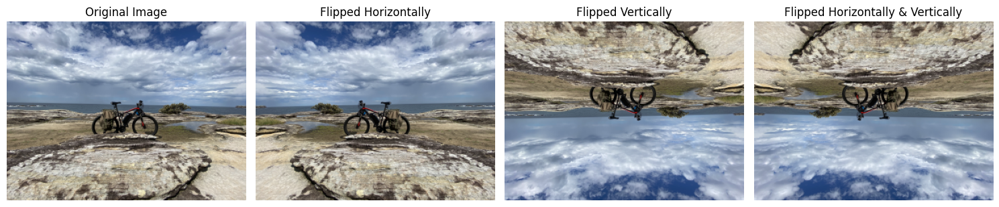

In [28]:

# List of flip codes
flip_codes = [1, 0, -1]
flip_labels = ['Flipped Horizontally', 'Flipped Vertically', 'Flipped Horizontally & Vertically']

# Create a subplot for displaying the flipped images
fig, axs = plt.subplots(1, len(flip_codes)+1, figsize=(15, 5))

# Display the original image
axs[0].imshow(cv2.cvtColor(ratio_resized_bike, cv2.COLOR_BGR2RGB))
axs[0].set_title('Original Image')
axs[0].axis("off")

# Flip the image using different codes and display them in the plot
for i, code in enumerate(flip_codes, start=1):
    flipped = cv2.flip(ratio_resized_bike, code)
    axs[i].imshow(cv2.cvtColor(flipped, cv2.COLOR_BGR2RGB))
    axs[i].set_title(flip_labels[i-1])
    axs[i].axis("off")

# Adjust spacing and display the plot
plt.tight_layout()

plt.show()


#Crop Image with OpenCV

Cropping an image involves selecting a specific Region Of Interest (ROI) and extracting it from the original image. With powerful cv2 module, OpenCV provides seamless support for this task. Since images in OpenCV are represented as NumPy arrays, we can use array slicing to extract the desired ROI based on coordinates or dimensions.

To get started, we can examine the image format by printing the ratio of the resized bike image. This information can be used in photo editing software to precisely define the cropping region.

OpenCV offers efficient image cropping using NumPy array slicing. The process involves specifying the desired row and column ranges as follows.
```
image[startY:endY, startX:endX]
```

We can effortlessly crop the image by assigning appropriate values to startY, endY, startX, and endX. Slicing along the startY:endY range selects specific rows while slicing along the startX:endX range extracts the desired columns within the image. This flexibility allows us to accurately extract the ROI for further analysis or processing.

Using OpenCV, you can run the provided code to observe the complete image-cropping process. Feel free to modify the cropping coordinates or dimensions to meet your requirements.




In [29]:

print(f"Examine the dimensions of the resized bike image's ratio\nwidth: {ratio_resized_bike.shape[1]} pixels\nheight: {ratio_resized_bike.shape[0]} pixels\nchannels: {ratio_resized_bike.shape[2]}")


Examine the dimensions of the resized bike image's ratio
width: 300 pixels
height: 225 pixels
channels: 3


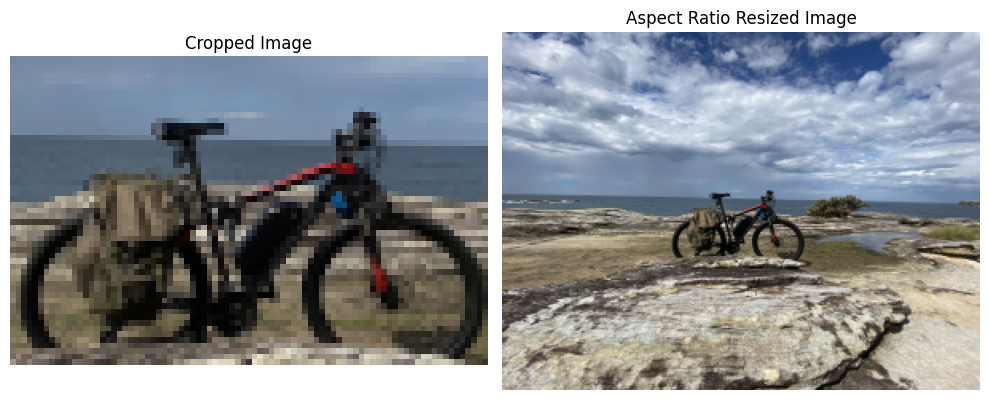

In [30]:
#determine the ROI 
crop=ratio_resized_bike[90:145,105:190]

# Create a figure with subplots
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Plot the cropped image
axs[0].imshow(imutils.opencv2matplotlib(crop))
axs[0].set_title("Cropped Image")
axs[0].axis("off")


# Plot the aspect ratio resized image
axs[1].imshow(imutils.opencv2matplotlib(ratio_resized_bike))
axs[1].set_title("Aspect Ratio Resized Image")
axs[1].axis("off")

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


#Image Arithmetic with OpenCV

Image Arithmetic is a fundamental concept in image processing that involves performing mathematical operations on pixel values to achieve desired modifications or transformations. OpenCV provides several functions for Image Arithmetic, including cv2.add(), cv2.subtract(), cv2.divide(), and cv2.multiply().

(-0.5, 4031.5, 3023.5, -0.5)

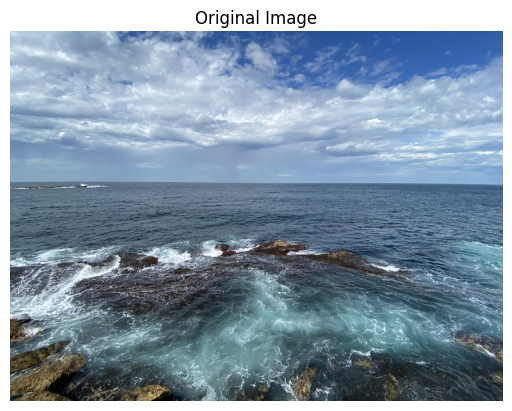

In [33]:
# Plotting the original image
plt.imshow(cv2.cvtColor(coogee_beach, cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis('off')

**cv2.add()** function adds pixel values between two images of the same size or between an image and a constant weight. The function performs element-wise addition, which computes the sum of corresponding pixels from the input images or between an image and a constant weight. The result is an output image with the combined pixel values. This operation is useful for various tasks such as adjusting brightness, creating overlays, or blending images. 

(-0.5, 4031.5, 3023.5, -0.5)

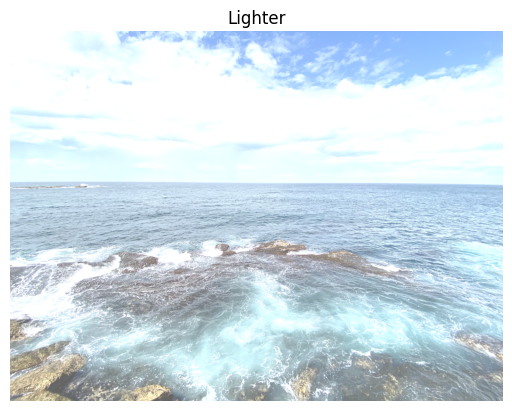

In [34]:
# Adding a constant value to the image
M = np.ones(coogee_beach.shape, dtype="uint8") * 100
added = cv2.add(coogee_beach, M)
plt.imshow(cv2.cvtColor(added, cv2.COLOR_BGR2RGB))
plt.title("Lighter")
plt.axis('off')

Similarly, the **cv2.subtract()** It subtracts pixel values between two images of the same size or between an image and a constant value. The function performs element-wise subtraction, which means it computes the difference between corresponding pixels from the input images or between an image and a constant value. The result is an output image with the subtracted pixel values. This operation is commonly employed for creating image masks, removing backgrounds, or highlighting image differences.

(-0.5, 4031.5, 3023.5, -0.5)

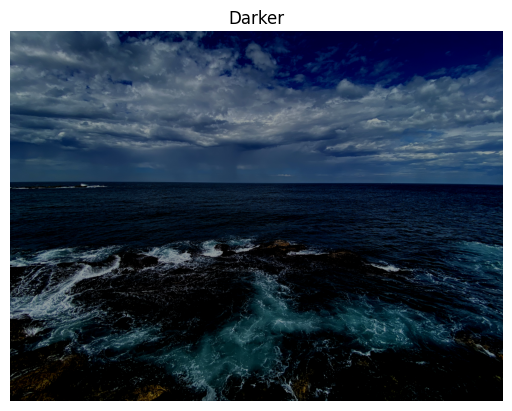

In [36]:
# Subtracting a constant value from the image
M = np.ones(coogee_beach.shape, dtype="uint8") * 100
subtracted = cv2.subtract(coogee_beach, M)
plt.imshow(cv2.cvtColor(subtracted, cv2.COLOR_BGR2RGB))
plt.title("Darker")
plt.axis('off')

**cv2.divide()** function performs pixel-wise division between two images or between an image and a scalar value. It calculates the quotient of corresponding pixels and generates an output image with the divided pixel values. This operation is commonly used for various purposes, such as normalization, attenuating pixel intensities, or implementing specific image filters. By dividing the pixel values, you can effectively adjust the intensity levels of an image or apply certain filters that rely on division operations.

(-0.5, 4031.5, 3023.5, -0.5)

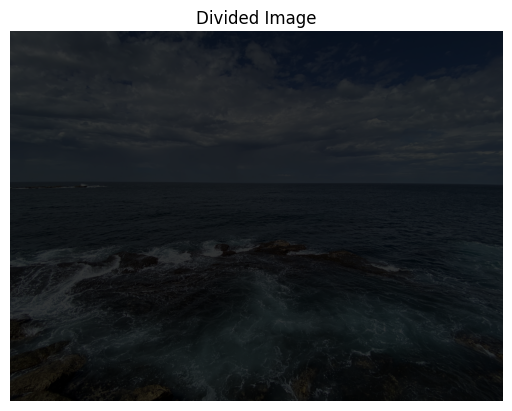

In [47]:
# Divide the image by a constant value
M = np.ones(coogee_beach.shape, dtype="uint8") * 5
divided = cv2.divide(coogee_beach, M)
plt.imshow(cv2.cvtColor(divided, cv2.COLOR_BGR2RGB))
plt.title("Divided Image")
plt.axis('off')

lastly, the **cv2.multiply()** function allows for pixel-wise multiplication between two images or between an image and a constant value. It computes the element-wise product of corresponding pixels and generates an output image with the multiplied pixel values. This operation is commonly used for various purposes, such as intensity scaling, contrast adjustments, or applying specific image effects. By multiplying the pixel values, you can effectively enhance or modify the intensity levels of an image, adjust the contrast, or achieve desired visual results.

(-0.5, 4031.5, 3023.5, -0.5)

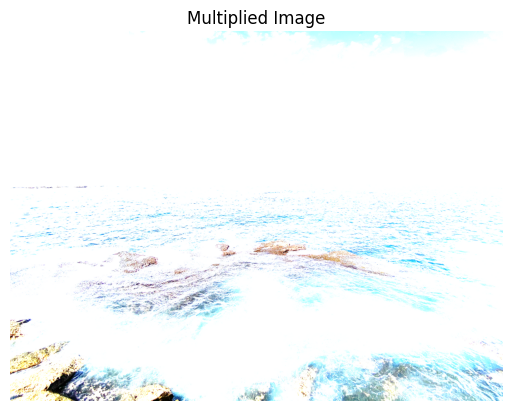

In [43]:
# Multiply the image by a constant value
M = np.ones(coogee_beach.shape, dtype="uint8") * 5
multiplied = cv2.multiply(coogee_beach, M)
plt.imshow(cv2.cvtColor(multiplied, cv2.COLOR_BGR2RGB))
plt.title("Multiplied Image")
plt.axis('off')

The choice of which operation to use depends on the desired effect and the specific requirements of the image-processing task. By adjusting the input images, constants, or scalar values, you can control the magnitude of the impact and achieve the desired result. It is essential to ensure the compatibility of the image data types for accurate and meaningful results.

In summary, Image Arithmetic operations in OpenCV provide a powerful toolbox for manipulating image pixel values. By utilizing cv2.add(), cv2.subtract(), cv2.divide(), and cv2.multiply(), various modifications such as brightness adjustments, contrast enhancements, normalization, or intensity scaling can be efficiently achieved. The appropriate operation is chosen based on the desired effect and the specific requirements of the image-processing task.

# Splitting & Merging Channels with OpenCV


Splitting and merging channels is a technique in image processing that allows us to manipulate individual colour channels of an image. OpenCV provides efficient functions, namely cv.split() and cv.merge(), for performing these operations.

When we split an image using cv.split(), it separates the image into its constituent colour channels, typically red, green, and blue (RGB). This results in three separate grayscale images, each representing the intensity of a specific colour channel. These individual channels can be processed independently to achieve desired effects. For instance, we can enhance the contrast of the red channel, adjust the brightness of the green channel, or apply a specific filter to the blue channel. By splitting the channels, we gain precise control over the colour information within the image.

On the other hand, when we merge channels using cv.merge(), we combine multiple grayscale images representing different colour channels into a single multichannel image. By specifying the order of the channels, we can reconstruct the original colour image. This merging operation is crucial after performing independent operations on individual colour channels. It allows us to combine the modified channels and generate the final output image.



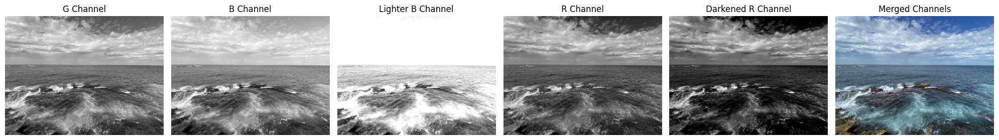

In [48]:
# Split the image channels
B, G, R = cv2.split(coogee_beach)

# Make adjustments to the channels
darkened_R = cv2.subtract(R, 50)  # Darken the red channel by subtracting 50 from its pixel values
lighter_B = cv2.add(B, 100)  # Lighten the blue channel by adding 100 to its pixel values

# Merge the channels back into an image
merged_image = cv2.merge([B, G, R])

# Set the figure size and create subplots
fig, axs = plt.subplots(1, 6, figsize=(20, 5))

# Display the individual channels
axs[0].imshow(G, cmap='gray')
axs[0].set_title("G Channel")
axs[0].axis('off')

axs[1].imshow(B, cmap='gray')
axs[1].set_title("B Channel")
axs[1].axis('off')

axs[2].imshow(lighter_B, cmap='gray')
axs[2].set_title("Lighter B Channel")
axs[2].axis('off')

axs[3].imshow(R, cmap='gray')
axs[3].set_title("R Channel")
axs[3].axis('off')

axs[4].imshow(darkened_R, cmap='gray')
axs[4].set_title("Darkened R Channel")
axs[4].axis('off')

# Display the merged image
axs[5].imshow(imutils.opencv2matplotlib(merged_image))
axs[5].set_title("Merged Channels")
axs[5].axis('off')

# Adjust spacing between subplots
fig.tight_layout()

# Show the plot
plt.show()



By utilizing the cv.split() and cv.merge() functions in OpenCV, we can effectively manipulate the colour channels of an image for various purposes, including colour correction, channel-based image analysis, and creating special effects. Understanding how to split and merge channels provides a powerful toolset to work with colour information and achieve precise control over image processing.

#Summary 

In this notebook I covered the basics techniqes of OpenCV such as loading and displaying images, resizing and interpolation, translation, rotation, flipping, cropping, image arithmetic, and splitting and merging channels.


#Refrunses 

* https://github.com/PyImageSearch/imutils/tree/master
* https://medium.com/@wenrudong/what-is-opencvs-inter-area-actually-doing-282a626a09b3
* https://pyimagesearch.com/practical-python-opencv/